# COS424 final project - Kaur or Kendrick

In [4]:
import pandas as pd
import numpy as np
import random
import plotly.plotly as py
import plotly.graph_objs as go
from plotly import tools

from __future__ import print_function

import matplotlib
import matplotlib.cm as cm
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

from yellowbrick.cluster import SilhouetteVisualizer

In [299]:
# read the data in, this data was taken from kaggle
# poems from poetryfoundation.org
# rap lyrics from metrolyrics.com
poems = pd.read_csv("kaggle_poem_dataset.csv")
lyrics = pd.read_csv("lyrics.csv")
hiphop = lyrics[(lyrics["genre"] == "Hip-Hop")]
poems = poems.drop(columns=["Poetry Foundation ID", "Unnamed: 0"])
hiphop = hiphop.drop(columns=["index", "year", "genre"])
hiphop = hiphop.rename(columns={"song": "Title", "artist": "Author", "lyrics": "Content"})
hiphop = hiphop.reindex(columns=["Author", "Title", "Content"])
hiphop["Label"] = 1
poems["Label"] = 0

In [356]:
poems.shape

(15652, 4)

In [357]:
hiphop.shape

(33965, 4)

In [6]:
df = pd.concat([hiphop, poems])

In [7]:
# cleaning the data, getting rid of extra parts to the data which could negatively impact our analysis
df[['Content']] = df[['Content']].replace(['\n', '\[.*?\]', '\(.*?\)'], [' ', '', ''], regex = True)
df[['Content']] = df[['Content']].replace(['Verse 1:', 'Verse One:', 'Verse 2:', 'Verse Two:', 'Verse 3:', 'Verse Three:'], ['', '', '', '', '', ''], regex = True)
df[['Content']] = df[['Content']].replace(['Artist:', 'Album:', 'Song:'], ['', '', ''], regex = True)
df[['Content']] = df[['Content']].replace(['Bridge:', 'Chorus:', 'Hook'], ['', '', ''], regex = True)
df

,Author,Title,Content,Label
249,eazy-e,i-got-that,... Timbo- When you hit me on my phone betta ...,1
250,eazy-e,8-ball-remix,"I don't drink brass monkey, like to be funky ...",1
251,eazy-e,extra-special-thankz,"19 muthaphukkin 93, and I'm back in this bitch...",1
252,eazy-e,boyz-in-da-hood,"Hey yo man, remember that shit Eazy did a whil...",1
253,eazy-e,automoblie,"Yo, Dre, man, I take this bitch out to the mov...",1
254,eazy-e,i-d-rather-fuck-you,"Aah, this is one of them songs You can kick ba...",1
255,eazy-e,boyz-in-the-hood-remix,"Hey yo man, remember that shit Eazy did a whil...",1
256,eazy-e,fuck-dre,Master P ++++++++++ Ghetto Dope Pass Me Da ...,1
257,eazy-e,trust-no-bitch,Yes Im too smart to get dicked...or so the cas...,1
258,eazy-e,boyz-n-the-hood-g-mix,"Hey yo man, remember that shit Eazy did a whil...",1


In [8]:
df = df.fillna('')

In [9]:
# split the data, for comparing results
dfTrain, dfTest = train_test_split(df, test_size=0.2)

In [10]:
# these lines relate to sending the data between group members
dfTrain.to_csv('train.csv', encoding='utf-8')
dfTest.to_csv('test.csv', encoding='utf-8')

In [3]:
dfTrain = pd.read_csv("train_v2.csv")
dfTest = pd.read_csv("test_v2.csv")
len(dfTrain)

32354

In [43]:
dfTrain = dfTrain.dropna()
dfTest = dfTest.dropna()
dfTrain

,Unnamed: 0,Unnamed: 0.1,Author,Title,Content,Label
0,0,341665,don-omar,calm-my-nerves,"Rrrra, El Pentagono Nelly El Arma Secreta, El ...",1
1,1,13990,Lucille Lang Day,Tooth Painter,"He was tall, lean, serious about his professio...",0
2,3,42864,game,heart-breaker,Rev.Burke- Yeah.....We Steping In The Spot Loo...,1
3,4,7335,Lorenzo Thomas,The Leopard,The eyeballs on her behind are like fire Leapi...,0
4,8,4569,John Hodgen,For the Man with the Erection Lasting More tha...,"He’s supposed to call his doctor, but for now ...",0
5,9,1961,Geoffrey Chaucer,The Canterbury Tales: General Prologue,Here bygynneth the Book of the tales of Caunte...,0
6,10,215387,ernie-haase-signature-sound,we-shall-see-jesus,"Once on a hillside, people were gathered Hopin...",1
7,11,331727,die-antwoord,u-make-a-ninja-wanna-fuck,Hello baby You're beautiful I love you What's ...,1
8,12,8940,Erika L. Sánchez,Narco,Highway of Death — the indifference of snakes....,0
9,13,108957,esham,i-know-you-hate-me,I know you hate me bitch Cause I ain't rich An...,1


In [5]:
len(dfTrain)

32354

In [6]:
# create a term frequency-inverse document frequency matrix, and a bag-of-words matrix with the top 1000 features
vectorizer0 = TfidfVectorizer(max_features = 1000, stop_words = 'english', ngram_range=(1, 2))
X0 = vectorizer0.fit_transform(dfTrain['Content'])
vectorizer1 = CountVectorizer(max_features = 1000, stop_words = 'english', ngram_range=(1, 2))
X1 = vectorizer1.fit_transform(dfTrain['Content'])

In [82]:
vectorizer0.get_feature_names()

[u'10',
 u'50',
 u'act',
 u'afraid',
 u'age',
 u'ago',
 u'ah',
 u'ahead',
 u'ain',
 u'ain got',
 u'aint',
 u'air',
 u'al',
 u'alive',
 u'alright',
 u'amp',
 u'answer',
 u'arm',
 u'arms',
 u'art',
 u'ask',
 u'asked',
 u'ass',
 u'auf',
 u'away',
 u'ay',
 u'aye',
 u'babe',
 u'baby',
 u'bad',
 u'bag',
 u'ball',
 u'bang',
 u'bang bang',
 u'bank',
 u'bar',
 u'battle',
 u'beat',
 u'beats',
 u'beautiful',
 u'beauty',
 u'bed',
 u'beef',
 u'believe',
 u'beneath',
 u'benz',
 u'best',
 u'bet',
 u'better',
 u'big',
 u'bigger',
 u'bin',
 u'bird',
 u'birds',
 u'bit',
 u'bitch',
 u'bitches',
 u'black',
 u'blast',
 u'blind',
 u'block',
 u'blood',
 u'blow',
 u'blue',
 u'blunt',
 u'bodies',
 u'body',
 u'bomb',
 u'bone',
 u'boo',
 u'book',
 u'boom',
 u'booty',
 u'born',
 u'boss',
 u'bottle',
 u'bottles',
 u'bought',
 u'bounce',
 u'bout',
 u'bow',
 u'box',
 u'boy',
 u'boys',
 u'brain',
 u'brand',
 u'bread',
 u'break',
 u'breath',
 u'breathe',
 u'bright',
 u'bring',
 u'broke',
 u'broken',
 u'brother',
 u'br

In [100]:
import csv
with open('lda', 'wb') as myfile:
    wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
    wr.writerow(vectorizer0.get_feature_names())

In [83]:
vectorizer1.get_feature_names()

[u'10',
 u'50',
 u'act',
 u'afraid',
 u'age',
 u'ago',
 u'ah',
 u'ahead',
 u'ain',
 u'ain got',
 u'aint',
 u'air',
 u'al',
 u'alive',
 u'alright',
 u'amp',
 u'answer',
 u'arm',
 u'arms',
 u'art',
 u'ask',
 u'asked',
 u'ass',
 u'auf',
 u'away',
 u'ay',
 u'aye',
 u'babe',
 u'baby',
 u'bad',
 u'bag',
 u'ball',
 u'bang',
 u'bang bang',
 u'bank',
 u'bar',
 u'battle',
 u'beat',
 u'beats',
 u'beautiful',
 u'beauty',
 u'bed',
 u'beef',
 u'believe',
 u'beneath',
 u'benz',
 u'best',
 u'bet',
 u'better',
 u'big',
 u'bigger',
 u'bin',
 u'bird',
 u'birds',
 u'bit',
 u'bitch',
 u'bitches',
 u'black',
 u'blast',
 u'blind',
 u'block',
 u'blood',
 u'blow',
 u'blue',
 u'blunt',
 u'bodies',
 u'body',
 u'bomb',
 u'bone',
 u'boo',
 u'book',
 u'boom',
 u'booty',
 u'born',
 u'boss',
 u'bottle',
 u'bottles',
 u'bought',
 u'bounce',
 u'bout',
 u'bow',
 u'box',
 u'boy',
 u'boys',
 u'brain',
 u'brand',
 u'bread',
 u'break',
 u'breath',
 u'breathe',
 u'bright',
 u'bring',
 u'broke',
 u'broken',
 u'brother',
 u'br

# DATA ANALYSIS

In [300]:
poems[['Content']] = poems[['Content']].replace(['\n', '\[.*?\]', '\(.*?\)', '\xe2\x80\x99', '\xe2\x80\x9c', '\xc2\xa0', '\xe2\x80\x94', '\xe2\x80\x9d'], [' ', '', '', '', '', '', '', ''], regex = True)
poems_words = ' '.join(poems.Content)
poems_words

'Dear Writers, Im compiling the first in what I hope is a series of publications Im calling artists among artists. The theme for issue 1 is Faggot Dinosaur. I hope to hear from you! Thank you and best wishes. Philosophic in its complex, ovoid emptiness, a skillful pundit coined it as a sort of stopgap doorstop for those quaint equations  Romans never dreamt of. In form completely clever and discretea mirror come unsilvered, loose watch face without the works, a hollowed globe  from tip to toe unbroken, it evades the grappling hooks of mass, tilts the thin rim of no thing, remains embryonic sum, non-cogito. We\'d like to talk with you about fear they said so many people live in fear these days they drove up all four of them in a small car nice  boy they said beautiful dogs they said so friendly the man ahead of the woman the other two waiting in the drive I was outside digging up the garden no one home I said what  are you selling  anyway I\'m  not interested I said well you have a nice

In [314]:
import nltk
from nltk.corpus import stopwords
from nltk.text import Text 
import os.path
import numpy as np
import matplotlib.pyplot as plt

tokens = nltk.word_tokenize(poems_words.decode('utf-8'))
tokens = [x.lower() for x in tokens]
stop_words = stopwords.words('english')
stop_words.extend([',', '.', ';', ':', 'like', '?', '!', "'s", "'d", '&', 'amp', '``', "'"])
filtered_poems = [word for word in tokens if word not in stop_words]
for w in tokens:
    if w not in stop_words:
        filtered_poems.append(w)
mytext = nltk.Text(filtered_poems)
fdist = nltk.FreqDist(mytext)
print(fdist.most_common(50))

[(u'one', 26620), (u'us', 14116), (u'love', 13110), (u'would', 12608), (u'time', 11532), (u'back', 11266), (u'could', 11182), (u'know', 11066), (u'see', 11020), (u'man', 10780), (u'day', 10506), (u'night', 10450), (u'still', 10154), (u'light', 10060), (u'life', 9616), (u'never', 9542), (u'said', 9376), (u'eyes', 9366), (u'way', 9204), (u'say', 9094), (u'thy', 8892), (u'old', 8706), (u'long', 8666), (u'world', 8666), (u'come', 8666), (u'go', 8076), (u'little', 7956), (u'yet', 7714), (u'even', 7596), (u'white', 7352), (u'let', 7316), (u'away', 7230), (u'made', 7218), (u'first', 7182), (u'heart', 7176), (u'thou', 7124), (u'god', 6828), (u'though', 6752), (u'water', 6680), (u'make', 6636), (u'face', 6598), (u'hand', 6570), (u'two', 6484), (u'every', 6454), (u'may', 6424), (u'last', 6418), (u'nothing', 6418), (u'men', 6410), (u'black', 6406), (u'shall', 6354)]


In [ ]:
hiphop[['Content']] = hiphop[['Content']].replace(['\n', '\[.*?\]', '\(.*?\)'], [' ', '', ''], regex = True)
hiphop[['Content']] = hiphop[['Content']].replace(['Verse 1:', 'Verse One:', 'Verse 2:', 'Verse Two:', 'Verse 3:', 'Verse Three:'], ['', '', '', '', '', ''], regex = True)
hiphop[['Content']] = hiphop[['Content']].replace(['Artist:', 'Album:', 'Song:'], ['', '', ''], regex = True)
hiphop[['Content']] = hiphop[['Content']].replace(['Bridge:', 'Chorus:', 'Hook'], ['', '', ''], regex = True)

In [318]:
hiphop['Content'] = hiphop['Content'].astype(str)
lyrics_words = ' '.join(hiphop.Content)
tokens_lyrics = nltk.word_tokenize(lyrics_words.decode('utf-8'))
tokens_lyrics = [x.lower() for x in tokens_lyrics]
stop_words = stopwords.words('english')
stop_words.extend([',', '.', ';', ':', 'like', '?', '!', "'s", "'d", '&', 'amp', '``', "'", "n't", "'m", "''", 'ca', "'re'"])
filtered_lyrics = [word for word in tokens_lyrics if word not in stop_words]
for w in tokens:
    if w not in stop_words:
        filtered_lyrics.append(w)
mytext_lyrics = nltk.Text(filtered_lyrics)
fdist_lyrics = nltk.FreqDist(mytext_lyrics)
print(fdist_lyrics.most_common(50))

[(u'got', 83128), (u'get', 74834), (u'know', 64997), (u'ai', 42457), (u'nigga', 42203), (u'one', 41658), (u'see', 39053), (u'go', 37359), (u'love', 36747), (u'na', 36519), (u'shit', 36385), (u'back', 36267), (u'let', 34875), (u'man', 33039), (u'make', 32054), (u'ya', 31204), (u'time', 29997), (u"'ll", 29841), (u'niggas', 29828), (u'never', 29103), (u'come', 28769), (u'want', 28480), (u'fuck', 28359), (u'say', 27547), (u'yeah', 27455), (u'yo', 25355), (u'baby', 23783), (u'take', 23636), (u'way', 23577), (u"'re", 22817), (u'life', 22523), (u'gon', 22352), (u'right', 22302), (u'cause', 22187), (u'bitch', 21986), (u'wan', 21431), (u'girl', 21353), (u'could', 20719), (u'tell', 20651), (u'us', 20183), (u'money', 20062), (u'oh', 20029), (u'keep', 19905), (u'still', 19702), (u'need', 18093), (u'put', 17593), (u'give', 17486), (u'ta', 17428), (u"'cause", 17056), (u'would', 17034)]


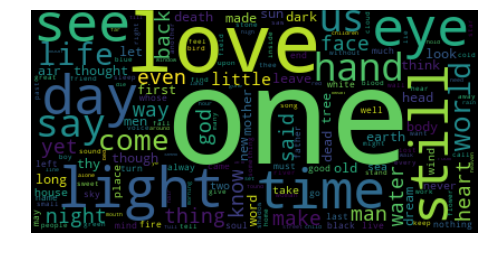

In [323]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import os.path

poems_string = " "
poems_string = poems_string.join(filtered_poems)
wc = WordCloud().generate(poems_string)
 
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

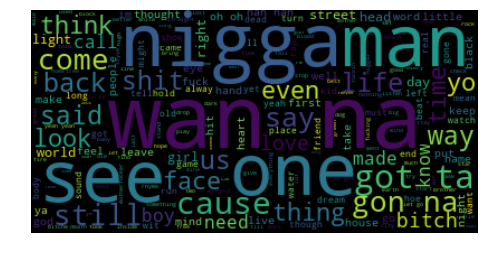

In [324]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import os.path

lyrics_string = " "
lyrics_string = lyrics_string.join(filtered_lyrics)
wc = WordCloud().generate(lyrics_string)
 
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [336]:
poem_lengths = []
for i in range(len(poems)):
    poem_lengths.append(len(poems.iloc[i]['Content'].split()))
    
poem_lengths

[39,
 66,
 113,
 150,
 77,
 356,
 97,
 129,
 360,
 268,
 113,
 117,
 715,
 132,
 145,
 155,
 219,
 225,
 313,
 82,
 162,
 683,
 114,
 78,
 70,
 85,
 139,
 43,
 313,
 354,
 284,
 204,
 190,
 29,
 120,
 150,
 309,
 306,
 207,
 48,
 48,
 209,
 572,
 162,
 282,
 156,
 247,
 124,
 129,
 240,
 117,
 223,
 275,
 147,
 159,
 32,
 544,
 51,
 138,
 109,
 313,
 296,
 173,
 14,
 1365,
 257,
 7683,
 172,
 431,
 230,
 160,
 111,
 2439,
 105,
 158,
 1115,
 192,
 278,
 748,
 48,
 143,
 505,
 349,
 351,
 331,
 29,
 58,
 103,
 134,
 542,
 162,
 41,
 98,
 102,
 537,
 78,
 88,
 289,
 59,
 705,
 860,
 109,
 91,
 173,
 94,
 103,
 189,
 106,
 321,
 136,
 112,
 198,
 168,
 41,
 93,
 366,
 135,
 254,
 169,
 104,
 37,
 90,
 305,
 110,
 137,
 84,
 158,
 41,
 91,
 141,
 69,
 64,
 201,
 386,
 563,
 112,
 704,
 254,
 455,
 419,
 93,
 164,
 300,
 199,
 135,
 4010,
 305,
 547,
 93,
 349,
 311,
 127,
 139,
 18,
 30,
 291,
 58,
 379,
 198,
 238,
 147,
 74,
 44,
 144,
 91,
 93,
 90,
 298,
 237,
 116,
 146,
 574,
 1181,


In [341]:
rap_lengths = []
hiphop = hiphop.fillna('')
for i in range(len(hiphop)):
    length = len(hiphop.iloc[i]['Content'].split())
    if length > 5:
        rap_lengths.append(length)
    
rap_lengths

[519,
 567,
 103,
 817,
 230,
 262,
 817,
 402,
 847,
 817,
 167,
 788,
 665,
 716,
 102,
 482,
 442,
 468,
 634,
 817,
 587,
 405,
 431,
 482,
 503,
 524,
 170,
 509,
 425,
 684,
 417,
 88,
 582,
 452,
 693,
 461,
 560,
 54,
 408,
 569,
 366,
 433,
 873,
 607,
 626,
 634,
 503,
 587,
 100,
 518,
 619,
 171,
 408,
 503,
 417,
 756,
 581,
 194,
 37,
 575,
 61,
 444,
 549,
 502,
 692,
 607,
 372,
 517,
 776,
 611,
 454,
 299,
 651,
 351,
 492,
 658,
 803,
 507,
 180,
 817,
 540,
 817,
 626,
 518,
 503,
 239,
 299,
 394,
 194,
 248,
 473,
 275,
 282,
 232,
 512,
 341,
 604,
 318,
 512,
 239,
 463,
 423,
 530,
 371,
 387,
 327,
 380,
 630,
 479,
 548,
 432,
 546,
 964,
 569,
 371,
 457,
 438,
 536,
 556,
 628,
 443,
 570,
 567,
 680,
 441,
 515,
 510,
 360,
 575,
 718,
 719,
 478,
 525,
 501,
 289,
 98,
 510,
 591,
 608,
 464,
 596,
 468,
 792,
 636,
 610,
 589,
 663,
 735,
 405,
 1068,
 606,
 351,
 19,
 518,
 478,
 568,
 675,
 432,
 40,
 576,
 616,
 606,
 521,
 535,
 219,
 574,
 583,
 581

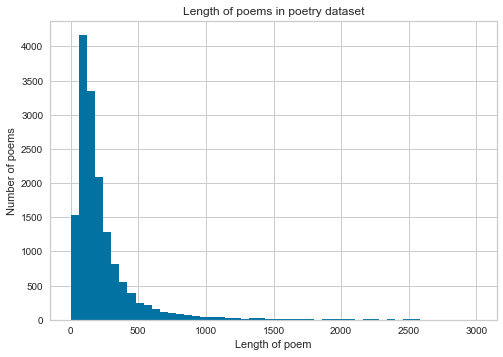

In [354]:
plt.hist(poem_lengths, bins=50, range=(0, 3000))
plt.title("Length of poems in poetry dataset")
plt.xlabel("Length of poem")
plt.ylabel("Number of poems")
plt.show()

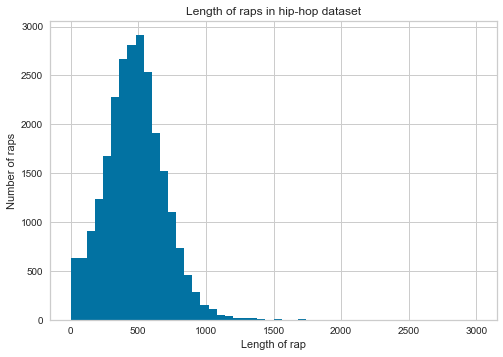

In [355]:
plt.hist(rap_lengths, bins=50, range=(0, 3000))
plt.title("Length of raps in hip-hop dataset")
plt.xlabel("Length of rap")
plt.ylabel("Number of raps")
plt.show()

# Fitting LDA

In [48]:
# fit on different numbers of components, then we compare the log likelihood and perplexity!
lda0 = LatentDirichletAllocation(n_components=2)
W0 = lda0.fit_transform(X0)
W0_components = lda0.components_
W0_components

array([[ 11.74003849,   0.69252577,  31.21012357, ..., 158.28782471,
         58.46158136,  46.27060592],
       [ 64.03983623,  79.61265982, 124.4593913 , ..., 143.30192928,
          1.30194295,   0.55588564]])

In [224]:
lda0_3 = LatentDirichletAllocation(n_components=3)
W0_3 = lda0_3.fit_transform(X0)
W0_3_components = lda0_3.components_
W0_3_components

array([[ 57.81495788,  78.94832053, 108.71114861, ..., 140.37912862,
         59.08799322,   0.34063341],
       [  9.64660101,   0.83751481,  26.54596979, ...,  58.68119284,
          0.33737001,  46.14921948],
       [  8.31831584,   0.51935025,  20.41239646, ..., 102.52943254,
          0.33816108,   0.33663868]])

In [325]:
lda0_4 = LatentDirichletAllocation(n_components=4)
W0_4 = lda0_4.fit_transform(X0)
W0_4_components = lda0_4.components_
W0_4_components

array([[  2.58741217,   1.90280193,   0.47668122, ...,   0.80821641,
         59.00787311,  46.07208263],
       [  8.26184092,   3.6880074 ,  29.7761886 , ...,  43.22376243,
          0.25215243,   0.25077927],
       [ 53.92290788,  72.56852444,  95.71826038, ..., 131.76768119,
          0.25323876,   0.25330205],
       [ 11.00771376,   2.14585182,  29.69838467, ..., 125.79009396,
          0.25026002,   0.25032761]])

In [225]:
# code modified from sample analysis uploaded to course page by Jonathan Lu
# topic-keyword matrix
df_topic_keywords = pd.DataFrame(W0_3_components)

# assign column and index
df_topic_keywords.columns = vectorizer0.get_feature_names()
# df_topic_keywords.index = topicnames

# view
df_topic_keywords.head()

# code modified from sample analysis uploaded to course page by Jonathan Lu
# show top n keywords for each topic
def show_topics(vectorizer0=vectorizer0, lda0_3=lda0_3, n_words=20):
    keywords = np.array(vectorizer0.get_feature_names())
    topic_keywords = []
    for topic_weights in lda0_3.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer0=vectorizer0, lda0_3=lda0_3, n_words=20)        

# topic - keywords dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i+1) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14,Word 15,Word 16,Word 17,Word 18,Word 19
Topic 1,like,got,nigga,ain,don,shit,niggas,know,ya,cause,fuck,just,em,yo,yeah,bitch,money,ll,make,let
Topic 2,love,just,know,ve,don,time,like,ll,say,life,said,way,want,baby,think,girl,feel,let,away,things
Topic 3,like,light,amp,que,water,night,la,white,sun,eyes,old,dark,wind,thy,air,sea,earth,sky,long,day


In [326]:
# code modified from sample analysis uploaded to course page by Jonathan Lu
# topic-keyword matrix
df_topic_keywords = pd.DataFrame(W0_4_components)

# assign column and index
df_topic_keywords.columns = vectorizer0.get_feature_names()
# df_topic_keywords.index = topicnames

# view
df_topic_keywords.head()

# code modified from sample analysis uploaded to course page by Jonathan Lu
# show top n keywords for each topic
def show_topics(vectorizer0=vectorizer0, lda0_4=lda0_4, n_words=20):
    keywords = np.array(vectorizer0.get_feature_names())
    topic_keywords = []
    for topic_weights in lda0_4.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer0=vectorizer0, lda0_4=lda0_4, n_words=20)        

# topic - keywords dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i+1) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14,Word 15,Word 16,Word 17,Word 18,Word 19
Topic 1,la,que,mi,el,ich,da,en,und,te,se,dem,tu,es,di,lo,du,le,si,die,der
Topic 2,love,know,just,don,baby,girl,like,im,got,oh,ll,want,cause,let,ve,wanna,time,say,life,need
Topic 3,like,nigga,got,shit,niggas,don,ain,fuck,know,ya,cause,bitch,em,just,yo,yeah,money,ll,man,make
Topic 4,like,light,night,amp,love,eyes,old,water,day,white,long,sun,world,dark,time,heart,thy,life,wind,air


In [327]:
# model performance
# log likelihood: higher the better
print("log likelihood 2: ", (lda0.score(X0)/X0.shape[0]))

# perplexity: lower the better. perplexity = exp(-1. * log-likelihood per word)
print("perplexity 2: ", (lda0.perplexity(X0)/X0.shape[0]))

# model performance
# log likelihood: higher the better
print("log likelihood 3: ", (lda0_3.score(X0)/X0.shape[0]))

# perplexity: lower the better. perplexity = exp(-1. * log-likelihood per word)
print("perplexity 3: ", (lda0_3.perplexity(X0)/X0.shape[0]))

# model performance
# log likelihood: higher the better
print("log likelihood 4: ", (lda0_4.score(X0)/X0.shape[0]))

# perplexity: lower the better. perplexity = exp(-1. * log-likelihood per word)
print("perplexity 4: ", (lda0_4.perplexity(X0)/X0.shape[0]))

log likelihood 2:  -37.687432689404915
perplexity 2:  0.02536166062915718
log likelihood 3:  -38.359464811801324
perplexity 3:  0.028585199803823885
log likelihood 4:  -38.54156174893617
perplexity 4:  0.029527148969428096


In [85]:
# LDA fit with the bag-of-words matrix -- compare to tf-idf
lda1 = LatentDirichletAllocation(n_components=2)
W1 = lda1.fit_transform(X1)
W1_components = lda1.components_
W1_components

array([[2.89117935e+02, 3.12638413e+02, 2.13061951e+02, ...,
        1.46294404e+02, 2.00647489e+03, 1.69749448e+03],
       [8.77882065e+02, 8.69361587e+02, 2.60793805e+03, ...,
        5.64370560e+03, 5.25114038e-01, 5.05515115e-01]])

In [86]:
# code modified from sample analysis uploaded to course page by Jonathan Lu
# topic-keyword matrix
df_topic_keywords = pd.DataFrame(W0_components)

# assign column and index
df_topic_keywords.columns = vectorizer0.get_feature_names()
# df_topic_keywords.index = topicnames

# view
df_topic_keywords.head()

# code modified from sample analysis uploaded to course page by Jonathan Lu
# show top n keywords for each topic
def show_topics(vectorizer0=vectorizer0, lda0=lda0, n_words=20):
    keywords = np.array(vectorizer0.get_feature_names())
    topic_keywords = []
    for topic_weights in lda0.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer0=vectorizer0, lda0=lda0, n_words=20)        

# topic - keywords dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i+1) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14,Word 15,Word 16,Word 17,Word 18,Word 19
Topic 1,like,got,don,know,nigga,just,ain,cause,shit,niggas,ya,ll,fuck,want,yeah,baby,let,make,yo,em
Topic 2,like,love,light,night,day,eyes,old,world,heart,long,away,life,white,water,time,la,sun,amp,que,said


In [103]:
# model performance - normalized based on shape
# log likelihood: higher the better
print("log likelihood: ", (lda0.score(X0)/X0.shape[0]))

# perplexity: lower the better. perplexity = exp(-1. * log-likelihood per word)
print("perplexity: ", (lda0.perplexity(X0)/X0.shape[0]))

('log likelihood: ', -37.687432689404915)
('perplexity: ', 0.02536166062915718)


In [89]:
# code modified from sample analysis uploaded to course page by Jonathan Lu
# topic-keyword matrix
df_topic_keywords = pd.DataFrame(W1_components)

# assign column and index
df_topic_keywords.columns = vectorizer1.get_feature_names()
# df_topic_keywords.index = topicnames

# view
df_topic_keywords.head()

# code modified from sample analysis uploaded to course page by Jonathan Lu
# show top n keywords for each topic
def show_topics(vectorizer1=vectorizer1, lda1=lda1, n_words=20):
    keywords = np.array(vectorizer1.get_feature_names())
    topic_keywords = []
    for topic_weights in lda1.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer1=vectorizer1, lda1=lda1, n_words=20)        

# topic - keywords dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i+1) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14,Word 15,Word 16,Word 17,Word 18,Word 19
Topic 1,nigga,yo,la,niggas,ya,que,fuck,shit,ich,die,bitch,da,mi,wit,niggaz,em,und,el,ass,dem
Topic 2,like,know,got,don,just,ain,cause,love,let,make,ll,time,man,say,want,shit,come,way,life,baby


In [102]:
# model performance - normalized based on shape
# log likelihood: higher the better
print("log likelihood: ", (lda1.score(X1)/X1.shape[0]))

# perplexity: lower the better. perplexity = exp(-1. * log-likelihood per word)
print("perplexity: ", (lda1.perplexity(X1)/X1.shape[0]))

('log likelihood: ', -690.5936215029916)
('perplexity: ', 0.015847208778718477)


# applying LDA to test data from Test/Train split

In [49]:
vectorizer0_test = TfidfVectorizer(max_features = 1000, stop_words = 'english', ngram_range=(1, 2))
X0_test = vectorizer0_test.fit_transform(dfTest['Content'])
vectorizer1_test = CountVectorizer(max_features = 1000, stop_words = 'english', ngram_range=(1, 2))
X1_test = vectorizer1_test.fit_transform(dfTest['Content'])

In [105]:
vectorizer0_test.get_feature_names()

[u'10',
 u'40',
 u'50',
 u'act',
 u'age',
 u'ago',
 u'ah',
 u'ain',
 u'ain got',
 u'aint',
 u'air',
 u'al',
 u'alive',
 u'alright',
 u'amp',
 u'answer',
 u'arm',
 u'arms',
 u'art',
 u'ask',
 u'asked',
 u'ass',
 u'auf',
 u'away',
 u'ay',
 u'babe',
 u'baby',
 u'bad',
 u'bag',
 u'ball',
 u'bang',
 u'bank',
 u'bar',
 u'battle',
 u'beat',
 u'beats',
 u'beautiful',
 u'beauty',
 u'bed',
 u'beef',
 u'believe',
 u'benz',
 u'best',
 u'bet',
 u'better',
 u'big',
 u'bird',
 u'birds',
 u'bit',
 u'bitch',
 u'bitches',
 u'black',
 u'blast',
 u'blind',
 u'block',
 u'blood',
 u'blow',
 u'blue',
 u'blunt',
 u'bodies',
 u'body',
 u'bone',
 u'bones',
 u'boo',
 u'book',
 u'boom',
 u'booty',
 u'born',
 u'boss',
 u'bottle',
 u'bottles',
 u'bought',
 u'bounce',
 u'bout',
 u'bow',
 u'box',
 u'boy',
 u'boys',
 u'brain',
 u'brand',
 u'bread',
 u'break',
 u'breath',
 u'breathe',
 u'bright',
 u'bring',
 u'broke',
 u'broken',
 u'brother',
 u'brothers',
 u'brought',
 u'brown',
 u'buck',
 u'bullshit',
 u'burn',
 u'bu

In [106]:
vectorizer1_test.get_feature_names()

[u'10',
 u'40',
 u'50',
 u'act',
 u'age',
 u'ago',
 u'ah',
 u'ain',
 u'ain got',
 u'aint',
 u'air',
 u'al',
 u'alive',
 u'alright',
 u'amp',
 u'answer',
 u'arm',
 u'arms',
 u'art',
 u'ask',
 u'asked',
 u'ass',
 u'auf',
 u'away',
 u'ay',
 u'babe',
 u'baby',
 u'bad',
 u'bag',
 u'ball',
 u'bang',
 u'bank',
 u'bar',
 u'battle',
 u'beat',
 u'beats',
 u'beautiful',
 u'beauty',
 u'bed',
 u'beef',
 u'believe',
 u'benz',
 u'best',
 u'bet',
 u'better',
 u'big',
 u'bird',
 u'birds',
 u'bit',
 u'bitch',
 u'bitches',
 u'black',
 u'blast',
 u'blind',
 u'block',
 u'blood',
 u'blow',
 u'blue',
 u'blunt',
 u'bodies',
 u'body',
 u'bone',
 u'bones',
 u'boo',
 u'book',
 u'boom',
 u'booty',
 u'born',
 u'boss',
 u'bottle',
 u'bottles',
 u'bought',
 u'bounce',
 u'bout',
 u'bow',
 u'box',
 u'boy',
 u'boys',
 u'brain',
 u'brand',
 u'bread',
 u'break',
 u'breath',
 u'breathe',
 u'bright',
 u'bring',
 u'broke',
 u'broken',
 u'brother',
 u'brothers',
 u'brought',
 u'brown',
 u'buck',
 u'bullshit',
 u'burn',
 u'bu

In [112]:
with open('lda_test', 'wb') as myfile:
    wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
    wr.writerow(vectorizer0_test.get_feature_names())

UnicodeEncodeError: 'ascii' codec can't encode character u'\xfe' in position 0: ordinal not in range(128)

In [50]:
lda0_test = LatentDirichletAllocation(n_components=2)
W0_test = lda0_test.fit_transform(X0_test)
W0_components_test = lda0_test.components_
W0_components_test

array([[ 2.82080581,  0.95114324,  0.74974004, ..., 13.74187039,
         1.60098965,  2.01122416],
       [17.02086046, 17.52199513, 20.54585862, ...,  0.57099087,
         0.51126807,  0.51118748]])

In [108]:
lda1_test = LatentDirichletAllocation(n_components=2)
W1_test = lda1_test.fit_transform(X1_test)
W1_components_test = lda1_test.components_
W1_components_test

array([[5.67992771e+01, 7.95586869e+00, 9.40101501e+00, ...,
        4.60459576e+02, 5.04499589e+02, 7.08499629e+02],
       [2.48200723e+02, 2.72044131e+02, 3.10598985e+02, ...,
        5.40424194e-01, 5.00411032e-01, 5.00371078e-01]])

In [109]:
# code modified from sample analysis uploaded to course page by Jonathan Lu
# topic-keyword matrix
df_topic_keywords_test1 = pd.DataFrame(W0_components_test)

# assign column and index
df_topic_keywords_test1.columns = vectorizer0_test.get_feature_names()
# df_topic_keywords.index = topicnames

# view
df_topic_keywords_test1.head()

# code modified from sample analysis uploaded to course page by Jonathan Lu
# show top n keywords for each topic
def show_topics(vectorizer0_test=vectorizer0_test, lda0_test=lda0_test, n_words=20):
    keywords = np.array(vectorizer0_test.get_feature_names())
    topic_keywords_test1 = []
    for topic_weights in lda0_test.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords_test1.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer0_test=vectorizer0_test, lda0_test=lda0_test, n_words=20)        

# topic - keywords dataframe
df_topic_keywords_test1 = pd.DataFrame(topic_keywords)
df_topic_keywords_test1.columns = ['Word '+str(i) for i in range(df_topic_keywords_test1.shape[1])]
df_topic_keywords_test1.index = ['Topic '+str(i+1) for i in range(df_topic_keywords_test1.shape[0])]
df_topic_keywords_test1

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14,Word 15,Word 16,Word 17,Word 18,Word 19
Topic 1,nigga,yo,la,niggas,ya,que,fuck,shit,ich,die,bitch,da,mi,wit,niggaz,em,und,el,ass,dem
Topic 2,like,know,got,don,just,ain,cause,love,let,make,ll,time,man,say,want,shit,come,way,life,baby


In [110]:
# code modified from sample analysis uploaded to course page by Jonathan Lu
# topic-keyword matrix
df_topic_keywords_test2 = pd.DataFrame(W1_components_test)

# assign column and index
df_topic_keywords_test2.columns = vectorizer1_test.get_feature_names()
# df_topic_keywords.index = topicnames

# view
df_topic_keywords_test2.head()

# code modified from sample analysis uploaded to course page by Jonathan Lu
# show top n keywords for each topic
def show_topics(vectorizer1_test=vectorizer1_test, lda1_test=lda1_test, n_words=20):
    keywords = np.array(vectorizer1_test.get_feature_names())
    topic_keywords_test2 = []
    for topic_weights in lda1_test.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords_test2.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer1_test=vectorizer1_test, lda1_test=lda1_test, n_words=20)        

# topic - keywords dataframe
df_topic_keywords_test2 = pd.DataFrame(topic_keywords)
df_topic_keywords_test2.columns = ['Word '+str(i) for i in range(df_topic_keywords_test2.shape[1])]
df_topic_keywords_test2.index = ['Topic '+str(i+1) for i in range(df_topic_keywords_test2.shape[0])]
df_topic_keywords_test2

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14,Word 15,Word 16,Word 17,Word 18,Word 19
Topic 1,nigga,yo,la,niggas,ya,que,fuck,shit,ich,die,bitch,da,mi,wit,niggaz,em,und,el,ass,dem
Topic 2,like,know,got,don,just,ain,cause,love,let,make,ll,time,man,say,want,shit,come,way,life,baby


In [111]:
# model performance
# log likelihood: higher the better
print("log likelihood: ", (lda0_test.score(X0_test)/X0_test.shape[0]))

# perplexity: lower the better. perplexity = exp(-1. * log-likelihood per word)
print("perplexity: ", (lda0_test.perplexity(X0_test)/X0_test.shape[0]))

('log likelihood: ', -38.072579354854724)
('perplexity: ', 0.10684253063799916)


In [112]:
# model performance
# log likelihood: higher the better
print("log likelihood: ", (lda1_test.score(X1_test)/X1_test.shape[0]))

# perplexity: lower the better. perplexity = exp(-1. * log-likelihood per word)
print("perplexity: ", (lda1_test.perplexity(X1_test)/X1_test.shape[0]))

('log likelihood: ', -699.5069053650207)
('perplexity: ', 0.06263053948150395)


# Exploring the Results of LDA topics

In [113]:
# code modified from sample analysis uploaded to course page by Jonathan Lu
component_proportions = lda0.transform(X0)
# plt.figure()
# for i in range(2):
#     plt.hist(user_proportions_from_latent_topics[:, i], alpha=0.3, label="Topic " + str(i+1),
#             range=(0,1), bins=20)
# plt.xlabel("User Proportion from Topic i", fontsize=20)
# plt.ylabel("Count", fontsize=20)
# plt.tick_params(labelsize=15)
# plt.legend()
# plt.show()
component_proportions

array([[0.24203633, 0.75796367],
       [0.17903867, 0.82096133],
       [0.88931017, 0.11068983],
       ...,
       [0.88997716, 0.11002284],
       [0.82941422, 0.17058578],
       [0.25406824, 0.74593176]])

In [136]:
# pulling out individual spotlights
approx_middle_points = []
end_points = []
for i in range(len(component_proportions)):
    if (component_proportions[i][0] > 0.49 and component_proportions[i][0] < 0.51 and component_proportions[i][0] != 0.5):
        approx_middle_points.append(i)
    if (component_proportions[i][0] > 0.9 or component_proportions[i][0] < 0.1):
        end_points.append(i)
        
len(approx_middle_points)

214

In [115]:
exactly_middle = []
for i in range(len(component_proportions)):
    if (component_proportions[i][0] == 0.5):
        exactly_middle.append(i)
len(exactly_middle)

107

In [135]:
# these are outliers -- not good data ! let's remove
print("some random choices with 0.5")
r1 = random.choice(exactly_middle)
print(r1)
print("iloc")
print(dfTrain.iloc[r1])
r2 = random.choice(exactly_middle)
print(r2)
print("iloc")
print(dfTrain.iloc[r2])
r3 = random.choice(exactly_middle)
print(r3)
print("iloc")
print(dfTrain.iloc[r3])

some random choices with 0.5
31925
iloc
Unnamed: 0                                             105753
Author                                               curren-y
Title                                                     woh
Content       Curren$y - WOH  Curren$y - WOH  Curren$y - WOH 
Label                                                       1
Name: 39171, dtype: object
12405
iloc
Unnamed: 0              82906
Author        cunninlynguists
Title                my-habit
Content          INSTRUMENTAL
Label                       1
Name: 15122, dtype: object
11950
iloc
Unnamed: 0                     5154
Author                 Yvor Winters
Title                  God of Roads
Content       I, peregrine of noon.
Label                             0
Name: 14591, dtype: object


In [131]:
# some 50/50 ones
dfTrain.iloc[5898]['Content']
dfTrain.iloc[15559]['Content']

'Not gigan-tic. Not roman-tic. Not artis-tic. Not majes-tic. Not magne-tic. Nor aesthe-tic. Ticks are strictly parasi-tic.'

In [142]:
print("some random choices with approx 0.5")
r1 = random.choice(approx_middle_points)
print(r1)
print("iloc")
print(dfTrain.iloc[r1])
r2 = random.choice(approx_middle_points)
print(r2)
print("iloc")
print(dfTrain.iloc[r2])
r3 = random.choice(approx_middle_points)
print(r3)
print("iloc")
print(dfTrain.iloc[r3])

some random choices with approx 0.5
12060
iloc
Unnamed: 0                                               144036
Author                                        buckshot-lefonque
Title                                              black-monday
Content        Black Monday That's what this joint is all ab...
Label                                                         1
Name: 14715, dtype: object
4380
iloc
Unnamed: 0                                                13894
Author                                             Eve L. Ewing
Title                                       to the notebook kid
Content       yo chocolate milk for breakfast kid. one leg o...
Label                                                         0
Name: 5353, dtype: object
31990
iloc
Unnamed: 0                                                12482
Author                                              John Dryden
Title         Song:\n  \n   Your hay it is mow'd, and your c...
Content       From King Arthur COMUS Your hay i

In [143]:
# some approx 50/50 ones
#dfTrain.iloc[17623]['Content']
#dfTrain.iloc[30178]['Content']
#dfTrain.iloc[7124]['Content']
#dfTrain.iloc[4380]['Content']

'yo chocolate milk for breakfast kid. one leg of your sweatpants rolled up scrounging at the bottom of your mama\xe2\x80\x99s purse for bus fare and gum pen broke and you got ink on your thumb kid  what\xe2\x80\x99s good, hot on the cement kid White Castle kid tongue stained purple cussin on the court till your little brother shows up with half a candy bar kid  got that good B in science kid you earned it kid etch your name in a tree hug your granny on her birthday think of Alaska when they shootin curled-up dreams of salmon safety tundra the farthest away place you ever saw in a book polar bears your new chess partners pickax in the ice Northern Lights kid  keep your notebook where your cousins won\xe2\x80\x99t find it. leave it on my desk if you want shuffle under carbon paper and a stamp that screams late yellow and red to draw the eye from the ocean you keep hidden in a jacked-up five star. your mama thought there was a secret in there thought they would laugh but that ain\xe2\x80\

In [58]:
len(dfTrain)

39693

In [59]:
len(end_points)

3223

In [150]:
# Create Document - Topic Matrix

# train / Tfidf
lda_output = lda0.transform(X0)

# Construct the k-means clusters
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3).fit_predict(lda_output)

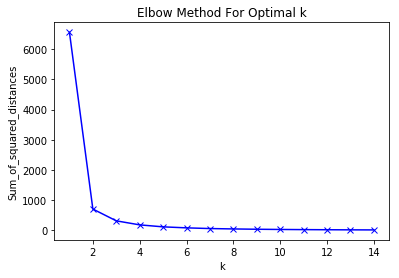

In [153]:
# plot elbow method in order to do "cross-validation" kinda and select a number of clusters
Sum_of_squared_distances = []
K = range(1,15)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(lda_output)
    Sum_of_squared_distances.append(km.inertia_)

plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [200]:
# compute silhoutte averages to determine an appropriate number of clusters
# code adapted from: https://www.scikit-yb.org/en/latest/api/cluster/silhouette.html
range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters = n_clusters)
    cluster_assignments = kmeans.fit_predict(W0)
    centers = kmeans.cluster_centers_
    silhouette_avg = silhouette_score(W0, cluster_assignments)
    sample_silhouette_values = silhouette_samples(W0, cluster_assignments)
    print("Silhoutte Average " + str(n_clusters))
    print(silhouette_avg)

Silhoutte Average 2
0.7803868412731333
Silhoutte Average 3
0.7176897308486417
Silhoutte Average 4
0.6691198057622613
Silhoutte Average 5
0.6283483188426097


In [ ]:
# Silhoutte Average 2
# 0.7891969055293094
# Silhoutte Average 3
# 0.7210556074313527
# Silhoutte Average 4
# 0.6690993242762576
# Silhoutte Average 5
# 0.6301208215477215

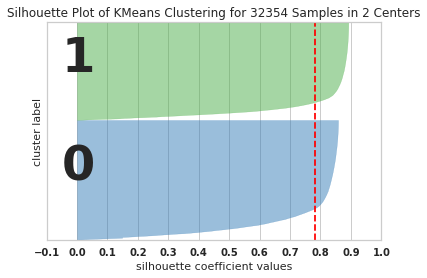

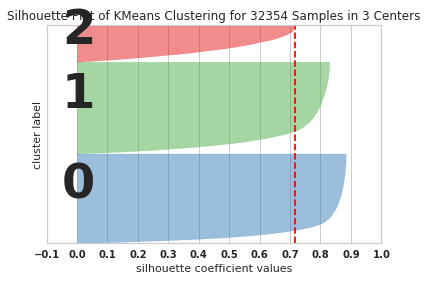

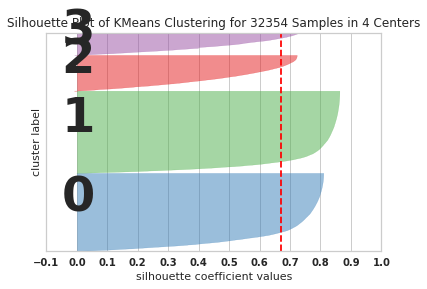

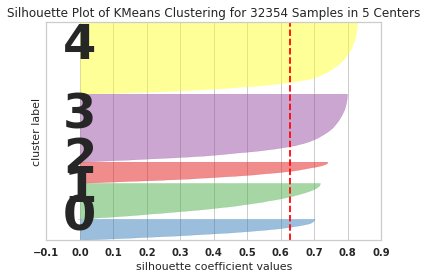

In [212]:
for n_clusters in range_n_clusters:
    # Instantiate the clustering model and visualizer
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    visualizer = SilhouetteVisualizer(clusterer)

    visualizer.fit(W0) # Fit the training data to the visualizer
    visualizer.poof() # Draw/show/poof the data

# Visualization

In [51]:
# these make it so that the data are more easily visualized
# code adapted from: https://stackoverflow.com/questions/8671808/matplotlib-avoiding-overlapping-datapoints-in-a-scatter-dot-beeswarm-plot
def rand_jitter(arr):
    stdev = .03*(max(arr)-min(arr))
    return arr + np.random.randn(len(arr)) * stdev

def jitter(x, y, s=20, c='b', marker='o', cmap=None, norm=None, vmin=None, vmax=None, alpha=None, linewidths=None, verts=None, hold=None, **kwargs):
    return plt.scatter(rand_jitter(x), rand_jitter(y), s=s, c=c, marker=marker, cmap=cmap, norm=norm, vmin=vmin, vmax=vmax, alpha=alpha, linewidths=linewidths, verts=verts, hold=hold, **kwargs)

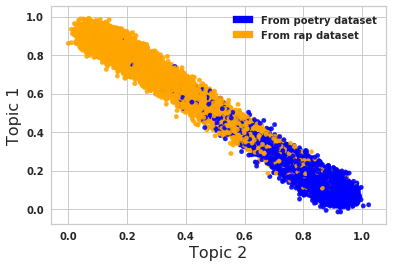

In [197]:
import matplotlib.patches as mpatches
colors = ['blue', 'orange']
label = dfTrain['Label']
# font = {'family' : 'normal',
#         'weight' : 'bold',
#         'size'   : 48}

# plt.rc('font', **font)
# using the actual labels, so that we can visualize how topic proportions were set in LDA
jitter(W0[:,0], W0[:,1], c=label, cmap=matplotlib.colors.ListedColormap(colors), alpha=0.9)
plt.xlabel('Topic 2', size=16)
plt.ylabel('Topic 1', size=16)
blue_patch = mpatches.Patch(color='blue', label='From poetry dataset')
orange_patch = mpatches.Patch(color='orange', label='From rap dataset')
plt.legend(handles=[blue_patch, orange_patch])

In [82]:
from sklearn.metrics import pairwise_distances_argmin_min
closest, _ = pairwise_distances_argmin_min(kmeans.cluster_centers_, W0)
closest

array([17612, 32227])

In [83]:
W0[17612]

array([0.80862258, 0.19137742])

In [84]:
W0[32227]

array([0.2036501, 0.7963499])

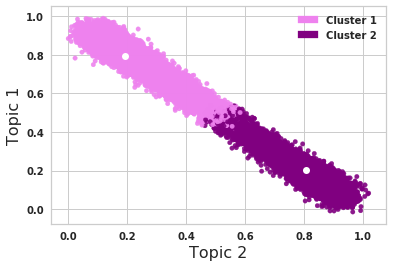

In [198]:
# plotting k means clusters
colors = ['violet', 'purple']
label = dfTrain['Label']
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 48}

plt.rc('font', **font)
jitter(W0[:,0], W0[:,1], c=dfY_clusters, cmap=matplotlib.colors.ListedColormap(colors), alpha=0.9)
plt.xlabel('Topic 2', size=16)
plt.ylabel('Topic 1', size=16)
plt.plot(kmeans.cluster_centers_[0], kmeans.cluster_centers_[1],'wo')
violet_patch = mpatches.Patch(color='violet', label='Cluster 1')
purple_patch = mpatches.Patch(color='purple', label='Cluster 2')
plt.legend(handles=[violet_patch, purple_patch])

In [81]:
kmeans.cluster_centers_

array([[0.80860735, 0.19139265],
       [0.2036359 , 0.7963641 ]])

# find vignettes -- interesting outliers, things close to cluster center, etc.

In [213]:
print("closest to centroid 2")
print(dfTrain.iloc[17612])
print(dfTrain.iloc[17612]['Content'])
print(W0[17612])

closest to centroid 2
Unnamed: 0                                                  21526
Unnamed: 0.1                                                 2580
Author                                                  Tim Wells
Title                                       The Coriolanus Effect
Content         For Jack the Ripper walking tours Come ye lear...
Label                                                           0
Name: 17612, dtype: object
For Jack the Ripper walking tours Come ye learned, ye loquacious, ye lost.  Walk a pentagram around ego, erudition, experience.  Our shuls, mosques, and homes be yours.  Our murdered laid bare, our slums still teem, our souls sold.  As for us, we marvel as our own effluvia swirls widdershins.
[0.80862258 0.19137742]


In [214]:
print("closest to centroid 1")
print(dfTrain.iloc[32227])
print(dfTrain.iloc[32227]['Content'])
print(W0[32227])

closest to centroid 1
Unnamed: 0                                                  39547
Unnamed: 0.1                                               120654
Author                                                chris-brown
Title                                             off-that-liquor
Content         I can't lie girl, you so damn sexy Them other ...
Label                                                           1
Name: 32227, dtype: object
I can't lie girl, you so damn sexy Them other girls ain't got nothin' on ya Patron mixed with me, that's your recipe I ain't gotta say it, I'll show ya You're picture perfect girl, don't change a thing Ain't goin' no where, you got me So when you're leavin' that party baby, Come on over, we can get it started baby, like Come, if it's loving that you need, from me Come close, 'cause your happiness is all that matters to me Girl I know, I'ma cherish what I have And now I'm holding your body, I love holding your body If I don't give it to you, be calli

In [63]:
# finding those outliers
rap_misclustered = []
poetry_misclustered = []
for i in range(len(W0)):
    if (W0[i][0] > 0.8 and dfTrain.iloc[i]['Label'] == 1):
        rap_misclustered.append(i)
    if (W0[i][1] > 0.8 and dfTrain.iloc[i]['Label'] == 0):
        poetry_misclustered.append(i)

# misclustered isn't the right wording here -- it's more like: number of matrices which were primarily in the same topic as those of the opposite label
print("size of misclustered rap: ")
print(len(rap_misclustered))
print("size of misclustered poetry: ")
print(len(poetry_misclustered))

size of misclustered rap: 
712
size of misclustered poetry: 
9


In [74]:
print("random poetry mis-clustered")
r2 = random.choice(poetry_misclustered)
print(r2)
print(dfTrain.iloc[r2])
print(dfTrain.iloc[r2]['Content'])

random poetry mis-clustered
13872
Unnamed: 0                                                  16923
Unnamed: 0.1                                                14113
Author                                          Hailey Leithauser
Title                                      Triolet with Pachyderm
Content         I don’t have to outrun the elephant, I just ha...
Label                                                           0
Name: 13872, dtype: object
I don’t have to outrun the elephant, I just have to outrun you. I don’t have to race with a belligerent ten-point buck, outpace an elephant in musth. I don’t need to flee a wrathful firmament or dance with a choleric jackboot. I don’t have to outrun the elephant. I only have to outrun you.


In [70]:
# 27882 - Mix a Pancake by Christina Rossetti (poem)
# 11606 - sweep by elephant-man (rap)
# 30537 - Resume by Dorothy Parker (poem)
# 12499 - Lion and the Lamb by Bethel Music (rap -- CHRISTIAN)
# 18761 - Drag On by Mutant (rap)
# 8074 - Cliff Hanger by Blackalicious (rap)

In [210]:
print("drag on")
print(W0[18761])
print("cliff hanger")
print(W0[8074])
print("mix a pancake")
print(W0[27882])

drag on
[0.89609636 0.10390364]
cliff hanger
[0.84477493 0.15522507]
mix a pancake
[0.19741729 0.80258271]


In [207]:
dfTrain.iloc[30537]['Content']
print("topic proportion for poem spotlight")
print(W0[30537])

topic proportion for poem spotlight
[0.22678406 0.77321594]


In [208]:
print("topic proportion for rap spotlight")
print(W0[14388])

topic proportion for rap spotlight
[0.8014191 0.1985809]


In [67]:
print("random rap mis-clustered")
r1 = random.choice(rap_misclustered)
print(r1)
print(dfTrain.iloc[r1])
print(dfTrain.iloc[r1]['Content'])

random rap mis-clustered
14388
Unnamed: 0                                                  17558
Unnamed: 0.1                                               258108
Author                                                      drake
Title                                              where-were-you
Content          I have to watch the road I swear that every c...
Label                                                           1
Name: 14388, dtype: object
 I have to watch the road I swear that every car that passes has you in it I can't believe we're finished My life is movin' fast The time will often pass And something will remind me I can't put this behind me I thought you would've called by now, by now You could've had my all by now, by now It's been too many years for you to disappear And have me asking the question  I wonder whatever became of you Although, it's not that I'm surprised, it's not I didn't try It's not that I was frightened, of you Although, I said all goodbyes And, you ha

# supervised learning on K-means cluster labels

In [54]:
from sklearn.linear_model import LogisticRegression
kmeans = KMeans(n_clusters=2, random_state=10)
kmeans.fit_predict(W0)
dfY_labels = dfTrain['Label']
dfY_clusters = kmeans.labels_
kmeans.fit_predict(W0_test)
dfY_labels_test = dfTest['Label']
dfY_clusters_test = kmeans.labels_
print(dfY_clusters)
print(dfY_clusters_test)

[0 1 0 ... 0 0 0]
[1 0 0 ... 1 1 1]


In [156]:
# train data
LR = LogisticRegression().fit(X0, dfY_labels)

# predict
LR.predict(X0_test)

# print accuracy
print(LR.score(X0_test, dfY_labels_test))

0.5710062815617687


In [99]:
# find top ten features of logistic regression -- applied to entire tf-idf feature space
coefs_LR = LR.coef_[0]
top_ten_LR = np.argpartition(coefs_LR, -10)[-10:]
words = vectorizer0.get_feature_names()
for word in top_ten_LR:
    print(words[word])

shall
und
old
dark
heart
ich
woman
amp
eyes
water


In [140]:
dfX0 = pd.DataFrame()
dfX0 = pd.concat([pd.DataFrame(X0.toarray())], axis = 1)
dfX0_test = pd.DataFrame()
dfX0_test = pd.concat([pd.DataFrame(X0_test.toarray())], axis = 1)

In [138]:
dfPredictionTrain = pd.DataFrame()
# index of top 20 words found in latent topic space for LDA
dfa_index = [502, 355, 217, 463, 605, 443, 8, 119, 750, 604, 535, 500, 607, 185, 266, 978, 499, 24, 520]
for index in dfa_index:
    dfPredictionTrain = pd.concat([pd.DataFrame(dfX0[index])], axis = 1)

In [143]:
dfPredictionTest = pd.DataFrame()
# index of top 20 words found in latent topic space for LDA (test data)
dfa_index = [493, 346, 218, 457, 596, 436, 7, 115, 744, 595, 526, 491, 598, 187, 262, 974, 489, 23, 511]
for index in dfa_index:
    dfPredictionTest = pd.concat([pd.DataFrame(dfX0_test[index])], axis = 1)

In [145]:
print(dfPredictionTest.shape)
print(X0_test.shape)

(8119, 1)
(8119, 1000)


In [146]:
# train data
LR_lda = LogisticRegression().fit(dfPredictionTrain, dfY_labels)

# predict
LR_lda.predict(dfPredictionTest)

# print accuracy
print(LR_lda.score(dfPredictionTest, dfY_labels_test))

0.6449070082522478


In [153]:
y_scores_lda = SVC_label.decision_function(dfX0_test)
precision_lda, recall_lda, thresholds = precision_recall_curve(dfY_labels_test, y_scores_lda)
average_precision_lda = average_precision_score(dfY_labels_test, y_scores_lda)
print('Average precision-recall score LR (on lda words): {0:0.3f}'.format(
      average_precision_lda))

Average precision-recall score LR (on lda words): 0.607


In [157]:
# train data
LR_cluster = LogisticRegression().fit(X0, dfY_clusters)

# predict
LR_cluster.predict(X0_test)

# print accuracy
print(LR_cluster.score(X0_test, dfY_clusters_test))

0.523709816479862


In [80]:
from sklearn.svm import SVC
# train data
SVC_label = SVC().fit(X0, dfY_labels)
# predict
SVC_label.predict(X0_test)
print("label support vector")
print(SVC_label.score(X0_test, dfY_labels_test))
# train data
SVC_cluster = SVC().fit(X0, dfY_clusters)
# predict
SVC_cluster.predict(X0_test)
print("cluster support vector")
print(SVC_cluster.score(X0_test, dfY_clusters_test))

/usr/local/lib/python2.7/site-packages/sklearn/svm/base.py:196: FutureWarning:

The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.



label support vector
0.6187954181549452
cluster support vector
0.5404606478630373


In [105]:
from sklearn.svm import LinearSVC
# train data
LSVC_label = LinearSVC().fit(X0, dfY_labels)
# predict
LSVC_label.predict(X0_test)
print("label linear support vector")
print(LSVC_label.score(X0_test, dfY_labels_test))
# train data
LSVC_cluster = LinearSVC().fit(X0, dfY_clusters)
# predict
LSVC_cluster.predict(X0_test)
print("cluster linear support vector")
print(LSVC_cluster.score(X0_test, dfY_clusters_test))

label linear support vector
0.6038921049390319
cluster linear support vector
0.49070082522478137


In [88]:
from sklearn.metrics import precision_recall_curve
y_scores = SVC_label.decision_function(X0_test)
precision, recall, thresholds = precision_recall_curve(dfY_labels_test, y_scores)

In [89]:
from sklearn.metrics import average_precision_score
average_precision = average_precision_score(dfY_labels_test, y_scores)
print('Average precision-recall score SVC: {0:0.3f}'.format(
      average_precision))

Average precision-recall score SVC: 0.607


In [154]:
precision_SVC, recall_SVC, thresholds = precision_recall_curve(dfY_clusters_test, y_scores)

In [155]:
y_scores_test = SVC_cluster.decision_function(X0_test)
precision_SVC_C, recall_SVC_C, thresholds = precision_recall_curve(dfY_clusters_test, y_scores_test)
average_precision_test = average_precision_score(dfY_clusters_test, y_scores_test)
print('Average precision-recall score SVC clusters: {0:0.3f}'.format(
      average_precision_test))

Average precision-recall score SVC clusters: 0.492


In [163]:
y_scores_LR = LR.decision_function(X0_test)
precision_LR, recall_LR, thresholds = precision_recall_curve(dfY_labels_test, y_scores_LR)
average_precision_LR = average_precision_score(dfY_labels_test, y_scores_LR)
print('Average precision-recall score LR: {0:0.3f}'.format(
      average_precision_LR))

Average precision-recall score LR: 0.609


In [158]:
y_scores_LR_C = LR_cluster.decision_function(X0_test)
precision_LR_C, recall_LR_C, thresholds = precision_recall_curve(dfY_clusters_test, y_scores_LR_C)
average_precision_test_LR = average_precision_score(dfY_clusters_test, y_scores_LR_C)
print('Average precision-recall score LR clusters: {0:0.3f}'.format(
      average_precision_test_LR))

Average precision-recall score LR clusters: 0.551


In [176]:
y_scores_LSVC = LSVC_label.decision_function(X0_test)
precision_LSVC, recall_LSVC, thresholds = precision_recall_curve(dfY_labels_test, y_scores_LSVC)
average_precision_LSVC = average_precision_score(dfY_labels_test, y_scores_LSVC)
print('Average precision-recall score LSVC: {0:0.3f}'.format(
      average_precision_LSVC))

Average precision-recall score LSVC: 0.618


In [177]:
y_scores_LSVC_C = LSVC_cluster.decision_function(X0_test)
precision_LSVC_C, recall_LSVC_C, thresholds = precision_recall_curve(dfY_clusters_test, y_scores_LSVC_C)
average_precision_test_LSVC = average_precision_score(dfY_clusters_test, y_scores_LSVC_C)
print('Average precision-recall score LSVC clusters: {0:0.3f}'.format(
      average_precision_test_LSVC))

Average precision-recall score LSVC clusters: 0.537


(0.0, 1.0)

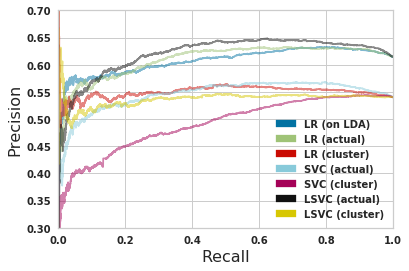

In [203]:
from funcsigs import signature
# In matplotlib < 1.5, plt.fill_between does not have a 'step' argument
# code adapted from Sklearn website: https://scikit-learn.org/stable/auto_examples/model_selection/plot_precision_recall.html#sphx-glr-auto-examples-model-selection-plot-precision-recall-py
# PLOT PRECISION RECALL CURVES
step_kwargs = ({'step': 'post'}
               if 'step' in signature(plt.fill_between).parameters
               else {})
plt.step(recall_lda, precision_lda, color='b', alpha=0.5,
         where='post')
plt.step(recall_LR, precision_LR, color='g', alpha=0.5,
         where='post')
plt.step(recall_LR_C, precision_LR_C, color='r', alpha=0.5,
         where='post')
plt.step(recall_SVC, precision_SVC, color='c', alpha=0.5,
         where='post')
plt.step(recall_SVC_C, precision_SVC_C, color='m', alpha=0.5,
         where='post')
plt.step(recall_LSVC, precision_LSVC, color='k', alpha=0.5,
         where='post')
plt.step(recall_LSVC_C, precision_LSVC_C, color='y', alpha=0.5,
         where='post')

l1 = mpatches.Patch(color='b', label='LR (on LDA)')
l2 = mpatches.Patch(color='g', label='LR (actual)')
l3 = mpatches.Patch(color='r', label='LR (cluster)')
l4 = mpatches.Patch(color='c', label='SVC (actual)')
l5 = mpatches.Patch(color='m', label='SVC (cluster)')
l6 = mpatches.Patch(color='k', label='LSVC (actual)')
l7 = mpatches.Patch(color='y', label='LSVC (cluster)')
plt.legend(handles=[l1, l2, l3, l4, l5, l6, l7])

plt.xlabel('Recall', size=16)
plt.ylabel('Precision', size=16)
plt.ylim([0.3, 0.7])
plt.xlim([0.0, 1.0])

In [184]:
# from sklearn import metrics
# roc_score = LR_lda.predict(dfPredictionTest)
# fpr, tpr, thresholds = metrics.roc_curve(dfY_clusters_test, roc_score, pos_label=2)

# plt.figure()
# lw = 2
# plt.plot(fpr[2], tpr[2], color='darkorange',
#          lw=lw)
# plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
# plt.xlim([0.0, 1.0])
# plt.ylim([0.0, 1.05])
# plt.xlabel('False Positive Rate')
# plt.ylabel('True Positive Rate')
# plt.title('Receiver operating characteristic example')
# plt.legend(loc="lower right")
# plt.show()